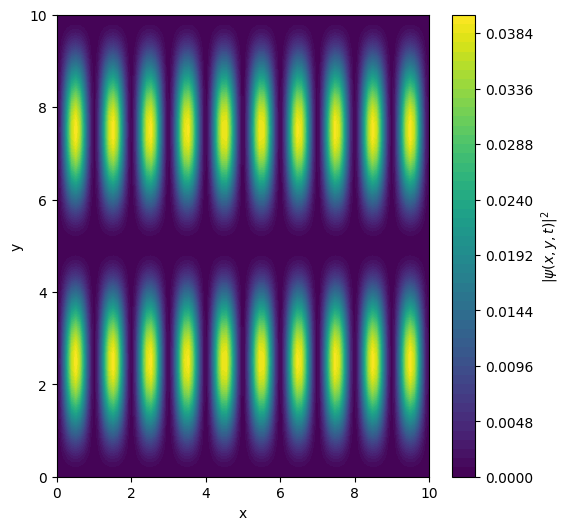

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Constants
L = 10.0  # Length of the box
m = 10.0  # Mass of the particle
hbar = 10.0  # Reduced Planck's constant
pi = np.pi

# Quantum numbers
nx = 10  # Quantum number in x-direction
ny = 200  # Quantum number in y-direction

# Energy calculation
def calculate_energy(nx, ny, L, m, hbar):
    return (hbar**2 * pi**2 / (2 * m * L**2)) * (nx**2 + ny**2)

# Wavefunction calculation (initial condition)
def wavefunction(nx, ny, x, y, L):
    return (2 / L) * np.sin(nx * pi * x / L) * np.sin(ny * pi * y / L)

# Time-dependent wavefunction
def time_dependent_wavefunction(nx, ny, x, y, t, L, E):
    psi_0 = wavefunction(nx, ny, x, y, L)
    return psi_0 * np.cos(E * t / hbar)  # Taking the real part for visualization

# Discretize the space
x = np.linspace(0, L, 100)
y = np.linspace(0, L, 100)
X, Y = np.meshgrid(x, y)

# Energy of the state
E = calculate_energy(nx, ny, L, m, hbar)

# Time evolution
t_values = np.linspace(0, 2 * pi, 100)

# Create the figure
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim(0, L)
ax.set_ylim(0, L)
ax.set_xlabel("x")
ax.set_ylabel("y")

# Initial plot
Z = time_dependent_wavefunction(nx, ny, X, Y, t=0, L=L, E=E)
contour = ax.contourf(X, Y, Z**2, levels=50, cmap="viridis")
cbar = plt.colorbar(contour, ax=ax)
cbar.set_label(r"$|\psi(x, y, t)|^2$")

# Update function for the animation
def update(t):
    Z = time_dependent_wavefunction(nx, ny, X, Y, t, L, E)
    ax.clear()
    contour = ax.contourf(X, Y, Z**2, levels=50, cmap="viridis")
    ax.set_title(f"Time: {t:.2f} s")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    return contour

# Create animation
ani = FuncAnimation(fig, update, frames=t_values, interval=100)

# Save the animation (optional)
# ani.save("quantum_wavefunction.mp4", writer="ffmpeg")

# Show the animation
plt.show()


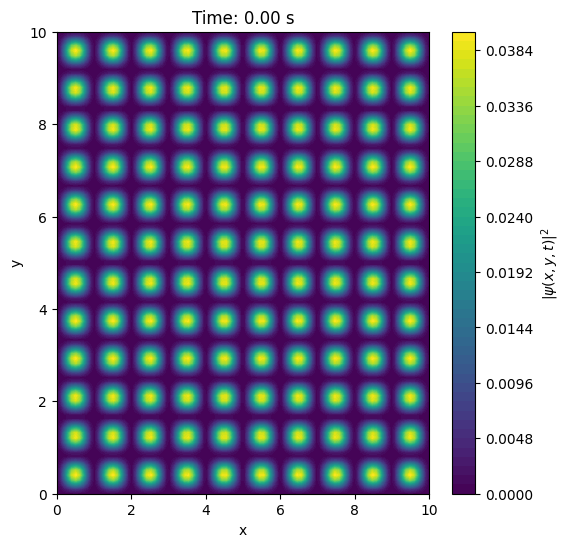

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Constants
L = 10.0  # Length of the box
m = 100.0  # Mass of the particle
hbar = 10.0  # Reduced Planck's constant
pi = np.pi

# Quantum numbers
nx = 10  # Quantum number in x-direction
ny = 12  # Quantum number in y-direction

# Energy calculation
def calculate_energy(nx, ny, L, m, hbar):
    return (hbar**2 * pi**2 / (2 * m * L**2)) * (nx**2 + ny**2)

# Wavefunction calculation (initial condition)
def wavefunction(nx, ny, x, y, L):
    return (2 / L) * np.sin(nx * pi * x / L) * np.sin(ny * pi * y / L)

# Time-dependent wavefunction
def time_dependent_wavefunction(nx, ny, x, y, t, L, E):
    psi_0 = wavefunction(nx, ny, x, y, L)
    return psi_0 * np.cos(E * t / hbar)  # Taking the real part for visualization

# Discretize the space
x = np.linspace(0, L, 100)
y = np.linspace(0, L, 100)
X, Y = np.meshgrid(x, y)

# Energy of the state
E = calculate_energy(nx, ny, L, m, hbar)

# Time evolution
t_values = np.linspace(0, 4 * pi, 100)

# Create the figure
fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim(0, L)
ax.set_ylim(0, L)
ax.set_xlabel("x")
ax.set_ylabel("y")

# Initial plot
Z = time_dependent_wavefunction(nx, ny, X, Y, t=0, L=L, E=E)
contour = ax.contourf(X, Y, Z**2, levels=50, cmap="viridis")
cbar = plt.colorbar(contour, ax=ax)
cbar.set_label(r"$|\psi(x, y, t)|^2$")

# Update function for the animation
def update(t):
    Z = time_dependent_wavefunction(nx, ny, X, Y, t, L, E)
    ax.clear()
    contour = ax.contourf(X, Y, Z**2, levels=50, cmap="viridis")
    ax.set_title(f"Time: {t:.2f} s")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    return contour

# Create animation
ani = FuncAnimation(fig, update, frames=t_values, interval=100)

# Embed the animation in the output
HTML_animation = HTML(ani.to_jshtml())

# Show the animation
HTML_animation


In [11]:
from qiskit import QuantumCircuit, Aer, execute
import numpy as np

# Function to apply Quantum Fourier Transform
def apply_qft(circuit, n):
    for j in range(n):
        for k in range(j):
            circuit.cp(np.pi / 2**(j-k), k, j)
        circuit.h(j)

# Function to reverse the order of qubits for correct QFT implementation
def swap_registers(circuit, n):
    for i in range(n // 2):
        circuit.swap(i, n - i - 1)

# Main function to demonstrate QFT
def quantum_fourier_transform_demo(num_qubits):
    # Create quantum circuit
    qc = QuantumCircuit(num_qubits)

    # Initialize qubits in a superposition state
    for qubit in range(num_qubits):
        qc.h(qubit)

    # Apply QFT
    apply_qft(qc, num_qubits)

    # Correct for qubit ordering
    swap_registers(qc, num_qubits)

    # Add measurement
    qc.measure_all()

    # Simulate the quantum circuit
    simulator = Aer.get_backend('qasm_simulator')
    result = execute(qc, simulator, shots=1024).result()
    counts = result.get_counts()

    return counts

# Parameters
num_qubits = 3  # Number of qubits for QFT demonstration
counts = quantum_fourier_transform_demo(num_qubits)

# Display Results
print("Measurement Results after QFT:")
for state, count in counts.items():
    print(f"{state}: {count}")


Measurement Results after QFT:
000: 1024


In [12]:
from qiskit import QuantumCircuit, Aer, execute
import numpy as np

# Function to apply Quantum Fourier Transform
def apply_qft(circuit, n):
    for j in range(n):
        for k in range(j):
            circuit.cp(np.pi / 2**(j-k), k, j)
        circuit.h(j)

# Function to reverse the order of qubits for correct QFT implementation
def swap_registers(circuit, n):
    for i in range(n // 2):
        circuit.swap(i, n - i - 1)

# Main function to demonstrate QFT
def quantum_fourier_transform_demo(num_qubits):
    # Create quantum circuit
    qc = QuantumCircuit(num_qubits)

    # Initialize qubits in a superposition state
    for qubit in range(num_qubits):
        qc.h(qubit)

    # Apply QFT
    apply_qft(qc, num_qubits)

    # Correct for qubit ordering
    swap_registers(qc, num_qubits)

    # Add measurement
    qc.measure_all()

    # Simulate the quantum circuit
    simulator = Aer.get_backend('qasm_simulator')
    result = execute(qc, simulator, shots=1024).result()
    counts = result.get_counts()

    return counts

# Parameters
num_qubits = 3  # Number of qubits for QFT demonstration
counts = quantum_fourier_transform_demo(num_qubits)

# Display Results
print("Measurement Results after QFT:")
for state, count in counts.items():
    print(f"{state}: {count}")


Measurement Results after QFT:
000: 1024
